Made with help of chatgpt and github copilot by feeding question subparts as prompt

In [29]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.models as models
import torchvision.datasets as datasets
import matplotlib.pyplot as plt
import numpy as np
from torch.utils.data import DataLoader, Dataset
from PIL import Image
import os

In [30]:
# Load ResNet18 model (pretrained on ImageNet)
model = models.resnet18(pretrained=True)

# Modify the final fully connected layer to output 10 classes instead of 1000
num_ftrs = model.fc.in_features
model.fc = nn.Linear(num_ftrs, 10)  # Change output to 10 classes

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Load model weights from the provided .pth file
checkpoint_path = "network_visualization.pth"  # Update with actual path
model.load_state_dict(torch.load(checkpoint_path, map_location=device))
model.eval()  # Set model to evaluation mode
print("✅ Model loaded successfully with updated last layer!")

✅ Model loaded successfully with updated last layer!


C:\Users\SHARS\AppData\Local\Temp\ipykernel_35412\2159143100.py:14: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(checkpoint_path, map_locat

In [31]:
MEAN = np.array([0.485, 0.456, 0.406])
STD = np.array([0.229, 0.224, 0.225])

# Define image transformations (Resize, Normalize)
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize to match ResNet input
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Function to load and preprocess an image
def load_image(image_path):
    image = Image.open(image_path).convert("RGB")
    image = transform(image).unsqueeze(0)  # Add batch dimension
    return image.to(device)  # Move to GPU if available

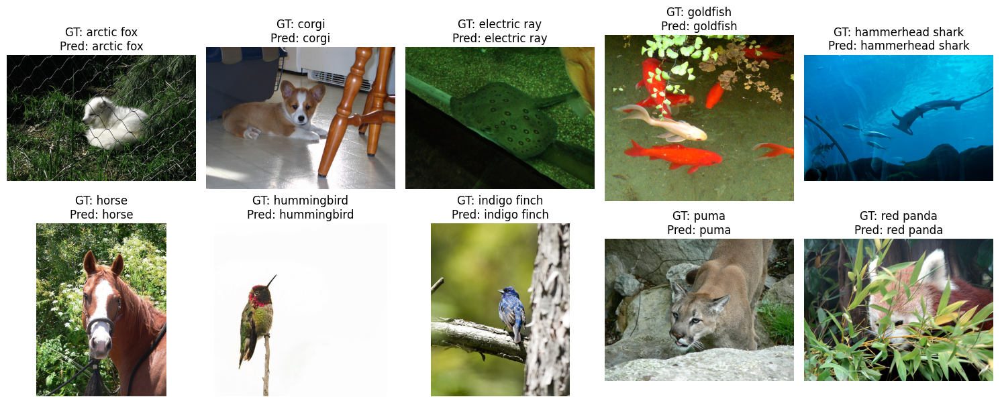

In [32]:
# Define class names in the order given in the PDF
class_names = ["arctic fox", "corgi", "electric ray", "goldfish", "hammerhead shark",
               "horse", "hummingbird", "indigo finch", "puma", "red panda"]

# Define dataset path (Update this with the actual dataset location)
dataset_path = "network visualization"  # Change to actual path

# Create a subset with one image per class
subset_images = {}
for class_name in class_names:
    class_dir = os.path.join(dataset_path, class_name)
    if os.path.exists(class_dir):
        image_name = os.listdir(class_dir)[0]  # Select first image
        subset_images[class_name] = os.path.join(class_dir, image_name)

# Load and visualize images
# Load images and get predictions
fig, axes = plt.subplots(2, 5, figsize=(15, 6))
for i, (class_name, img_path) in enumerate(subset_images.items()):
    img = load_image(img_path)
    output = model(img)  # Get predictions
    pred_class = torch.argmax(output, dim=1).item()
    pred_label = class_names[pred_class]

    # Load original image for display
    img_display = Image.open(img_path).convert("RGB")
    ax = axes[i // 5, i % 5]
    ax.imshow(img_display)
    ax.set_title(f"GT: {class_name}\nPred: {pred_label}")
    ax.axis("off")

plt.tight_layout()
plt.show()

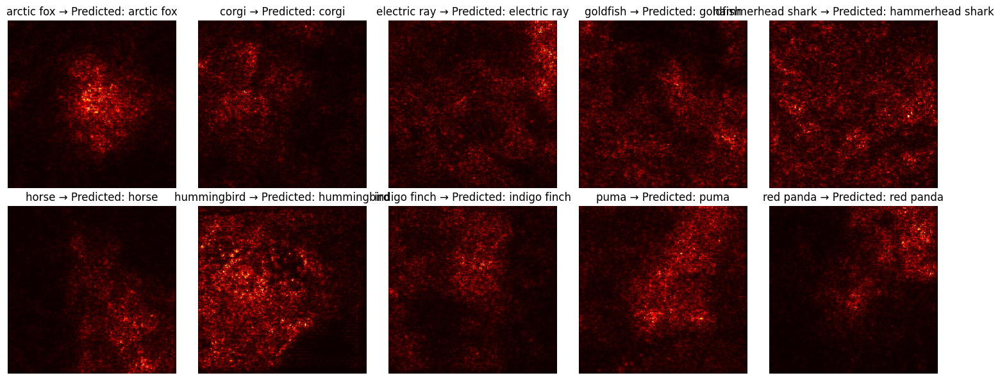

In [33]:
def compute_saliency_map(image_path, model):
    model.eval()  # Ensure model is in evaluation mode
    
    # Load and preprocess image
    image = load_image(image_path)
    image.requires_grad_()  # Enable gradient tracking for input image

    # Forward pass
    output = model(image)  # Get logits (before softmax)
    target_class = output.argmax(dim=1).item()  # Get predicted class

    # Backward pass to get gradients
    model.zero_grad()
    output[0, target_class].backward()  # Compute gradient of predicted class w.r.t. image

    # Get absolute value of gradients & take max across color channels
    saliency = image.grad.data.abs().squeeze().max(dim=0)[0]

    return saliency.cpu().numpy(), target_class

fig, axes = plt.subplots(2, 5, figsize=(15, 6))
for i, (class_name, img_path) in enumerate(subset_images.items()):
    saliency_map, pred_class = compute_saliency_map(img_path, model)

    # Show saliency map
    ax = axes[i // 5, i % 5]
    ax.imshow(saliency_map, cmap="hot")  # Use 'hot' colormap for visibility
    ax.set_title(f"{class_name} → Predicted: {class_names[pred_class]}")
    ax.axis("off")

plt.tight_layout()
plt.show()

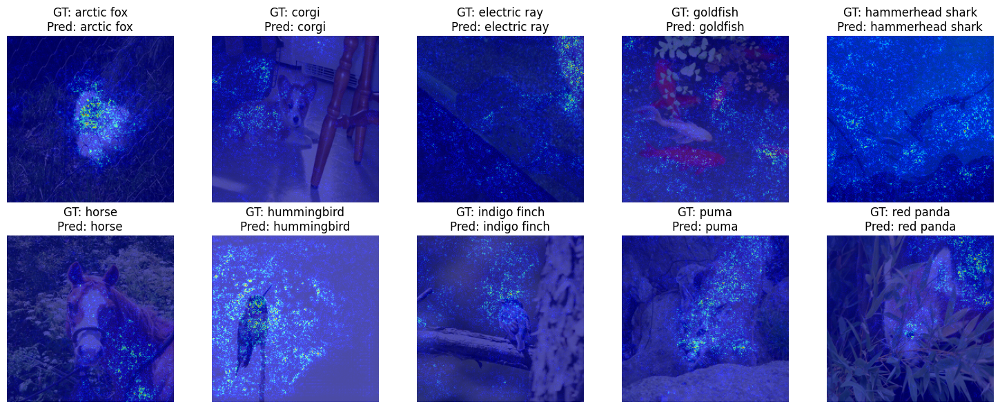

In [34]:
def overlay_saliency(image_path, saliency_map):
    img = Image.open(image_path).convert("RGB").resize((224, 224))
    img = np.array(img) / 255.0  # Normalize to [0,1]
    
    # Normalize saliency map to range [0, 1] and apply colormap
    saliency_map = (saliency_map - saliency_map.min()) / (saliency_map.max() - saliency_map.min())
    cmap = plt.cm.jet(saliency_map)[:, :, :3]  # Extract RGB channels from colormap
    
    # Blend using weighted sum, ensuring saliency colors remain strong
    overlay = (0.3 * img + 0.7 * cmap)  # Keep saliency more dominant
    overlay = np.clip(overlay, 0, 1)  # Ensure valid pixel range
    
    return overlay

fig, axes = plt.subplots(2, 5, figsize=(15, 6))
for i, (class_name, img_path) in enumerate(subset_images.items()):
    saliency_map, pred_class = compute_saliency_map(img_path, model)
    overlay = overlay_saliency(img_path, saliency_map)

    ax = axes[i // 5, i % 5]
    ax.imshow(overlay)
    ax.set_title(f"GT: {class_name}\nPred: {class_names[pred_class]}")
    ax.axis("off")

plt.tight_layout()
plt.show()

In [35]:
def apply_mask(image_path, saliency_map, mode="black", threshold=0.01):
    """
    Apply a mask to the image based on the saliency map.
    
    Parameters:
        image_path (str): Path to the original image.
        saliency_map (numpy array): The saliency map (normalized).
        mode (str): "black" for zero masking, "noise" for Gaussian noise.
        threshold (float): Saliency threshold below which pixels are masked.
    
    Returns:
        modified_image (numpy array): The masked image.
    """
    img = Image.open(image_path).convert("RGB").resize((224, 224))
    img = np.array(img) / 255.0  # Normalize to [0,1]
    
    # Normalize saliency map to range [0,1]
    saliency_map = (saliency_map - saliency_map.min()) / (saliency_map.max() - saliency_map.min())

    # Create a binary mask where saliency < threshold
    mask = saliency_map < threshold

    if mode == "black":
        img[mask] = [0, 0, 0]  # Set masked pixels to black
    elif mode == "noise":
        noise = np.random.normal(0.5, 0.2, img.shape)  # Gaussian noise (mean=0.5, std=0.2)
        img[mask] = noise[mask]  # Replace masked pixels with noise

    return np.clip(img, 0, 1)  # Ensure valid pixel range

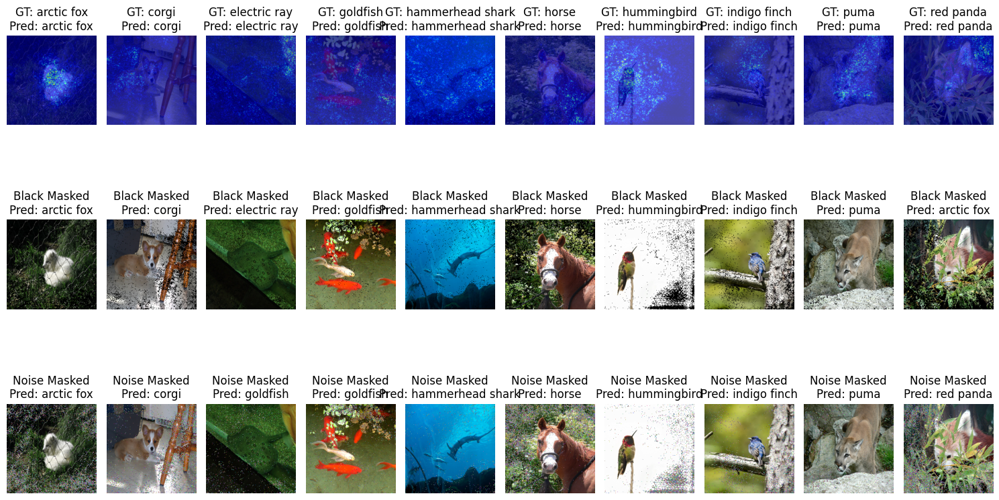

In [36]:
fig, axes = plt.subplots(3, len(subset_images), figsize=(15, 9))  # Dynamically adjust columns

for i, (class_name, img_path) in enumerate(subset_images.items()):
    saliency_map, pred_class = compute_saliency_map(img_path, model)
    
    # Apply different masking strategies
    black_masked = apply_mask(img_path, saliency_map, mode="black")
    noise_masked = apply_mask(img_path, saliency_map, mode="noise")

    # Convert to tensor & classify modified images
    black_img_tensor = transform(Image.fromarray((black_masked * 255).astype(np.uint8))).unsqueeze(0).to(device)
    noise_img_tensor = transform(Image.fromarray((noise_masked * 255).astype(np.uint8))).unsqueeze(0).to(device)

    pred_black = torch.argmax(model(black_img_tensor)).item()
    pred_noise = torch.argmax(model(noise_img_tensor)).item()

    # Correct indexing
    ax1 = axes[0, i]  # First row: Saliency overlay
    ax1.imshow(overlay_saliency(img_path, saliency_map))
    ax1.set_title(f"GT: {class_name}\nPred: {class_names[pred_class]}")
    ax1.axis("off")

    ax2 = axes[1, i]  # Second row: Black-masked image
    ax2.imshow(black_masked)
    ax2.set_title(f"Black Masked\nPred: {class_names[pred_black]}")
    ax2.axis("off")

    ax3 = axes[2, i]  # Third row: Noise-masked image
    ax3.imshow(noise_masked)
    ax3.set_title(f"Noise Masked\nPred: {class_names[pred_noise]}")
    ax3.axis("off")

plt.tight_layout()
plt.show()

theres 2 missclassifications , the electri ray is misclassified in the noise masked one to gold fish , and the red panda is missclassified to arctic fox in the black masked.

I can think of a few reaons for this ,
arctic fox and red panda have similar outlines (silhouettes) thus blacking out certain pixels causes fine fur and texture details of the face to be lost causing this misclassification

For the electric ray and gold fish , electric ray and goldfish differ in colour mainly (yellowish to greyish) so adding gaussian noise might shift colour of the electric ray to be more similar to gold fish instead causing such a missclassification

In [37]:
# Select another subset of images (1 per class) for adversarial attacks
adversarial_images = {}
for class_name in class_names:
    class_dir = os.path.join(dataset_path, class_name)
    if os.path.exists(class_dir):
        image_name = os.listdir(class_dir)[1]  # Select a different image (not used in saliency maps)
        adversarial_images[class_name] = os.path.join(class_dir, image_name)

In [38]:
def add_gaussian_noise(image, std=0.1):
    """
    Adds Gaussian noise to an image.
    
    Parameters:
        image (tensor): Input image tensor.
        std (float): Standard deviation of the noise.
    
    Returns:
        noisy_image (tensor): Noisy version of the image.
    """
    noise = torch.randn_like(image) * std
    noisy_image = image + noise
    return torch.clamp(noisy_image, 0, 1)  # Keep pixel values valid

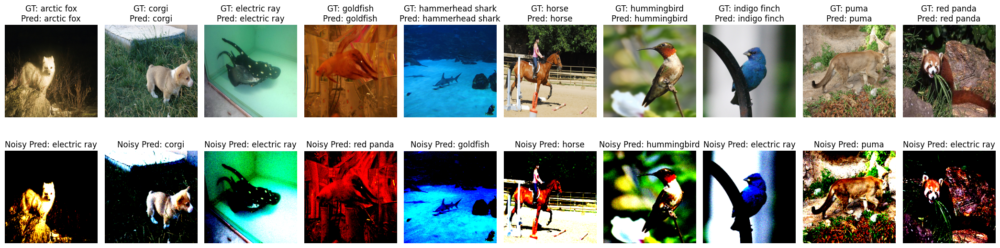

In [39]:
fig, axes = plt.subplots(2, 10, figsize=(21, 6))

for i, (class_name, img_path) in enumerate(adversarial_images.items()):
    img = load_image(img_path)
    noisy_img = add_gaussian_noise(img)

    pred_clean = torch.argmax(model(img)).item()
    pred_noisy = torch.argmax(model(noisy_img)).item()

    # Plot original image
    ax1 = axes[0, i]
    ax1.imshow(Image.open(img_path).resize((224, 224)))
    ax1.set_title(f"GT: {class_name}\nPred: {class_names[pred_clean]}")
    ax1.axis("off")

    # Plot noisy image
    ax2 = axes[1, i]
    ax2.imshow(noisy_img.cpu().squeeze(0).permute(1, 2, 0).numpy())
    ax2.set_title(f"Noisy Pred: {class_names[pred_noisy]}")
    ax2.axis("off")

plt.tight_layout()
plt.show()

the accuracy has reduced to 60% now which is 30% less than the gaussian masking based on saliency maps


In [40]:
def generate_adversarial_example(image, target_class, epsilon=0.05):
    """
    Generates an adversarial example using FGSM.
    
    Parameters:
        image (tensor): Input image.
        target_class (int): Target misclassification.
        epsilon (float): Strength of the attack.
    
    Returns:
        adversarial_image (tensor): Perturbed image.
    """
    image.requires_grad = True
    output = model(image)
    loss = torch.nn.CrossEntropyLoss()(output, torch.tensor([target_class]).to(device))
    
    model.zero_grad()
    loss.backward()
    
    perturbation = epsilon * image.grad.sign()
    adversarial_image = image + perturbation
    return torch.clamp(adversarial_image, 0, 1)  # Keep valid pixel range

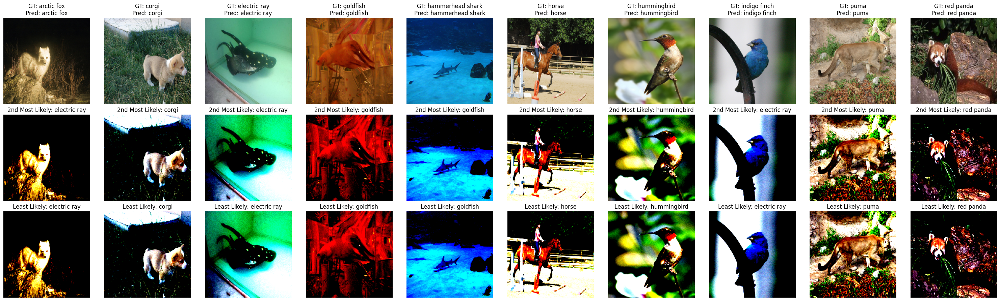

In [41]:
fig, axes = plt.subplots(3, 10, figsize=(30, 9))

for i, (class_name, img_path) in enumerate(adversarial_images.items()):
    img = load_image(img_path)

    # Get model predictions
    output = model(img)
    sorted_preds = torch.argsort(output, descending=True)
    second_most_likely = sorted_preds[0, 1].item()
    least_likely = sorted_preds[0, -1].item()

    # Generate adversarial examples
    adv_img_2nd = generate_adversarial_example(img, second_most_likely)
    adv_img_least = generate_adversarial_example(img, least_likely)

    pred_2nd = torch.argmax(model(adv_img_2nd)).item()
    pred_least = torch.argmax(model(adv_img_least)).item()

    # Plot original image
    ax1 = axes[0, i]
    ax1.imshow(Image.open(img_path).resize((224, 224)))
    ax1.set_title(f"GT: {class_name}\nPred: {class_names[sorted_preds[0,0].item()]}")
    ax1.axis("off")

    # Plot adversarial image (Second most likely)
    ax2 = axes[1, i]
    ax2.imshow(adv_img_2nd.detach().cpu().squeeze(0).permute(1, 2, 0).numpy())  # ✅ FIXED
    ax2.set_title(f"2nd Most Likely: {class_names[pred_2nd]}")
    ax2.axis("off")

    # Plot adversarial image (Least likely)
    ax3 = axes[2, i]
    ax3.imshow(adv_img_least.detach().cpu().squeeze(0).permute(1, 2, 0).numpy())  # ✅ FIXED
    ax3.set_title(f"Least Likely: {class_names[pred_least]}")
    ax3.axis("off")

plt.tight_layout()
plt.show()

In [25]:
from tqdm import tqdm

In [42]:
def get_target_class(logits, mode="next_highest"):
    probs = F.softmax(logits, dim=1)
    _, sorted_classes = torch.sort(probs, descending=True)
    
    if mode == "next_highest":
        return sorted_classes[0, 1].item()  # Second most likely class
    elif mode == "lowest":
        return sorted_classes[0, -1].item()  # Least likely class

# Function to Optimize Image Towards a Target Class
def optimize_image_for_class(model, image, target_class, steps=20, lr=0.005):
    image = image.clone().detach().requires_grad_(True)
    optimizer = torch.optim.Adam([image], lr=lr)

    for _ in tqdm(range(steps), desc="Optimizing Image"):
        optimizer.zero_grad()
        logits = model(image)
        loss = -logits[0, target_class]  # Maximize target class logit
        loss.backward()
        optimizer.step()

    return image.detach()

In [44]:
import torch.nn.functional as F

In [45]:
optimized_images_next = {}  # Store second most likely adversarial images
optimized_images_lowest = {}  # Store least likely adversarial images

for class_name, img_path in adversarial_images.items():
    img = load_image(img_path)  # Load and preprocess image
    logits = model(img)

    target_class_next = get_target_class(logits, mode="next_highest")
    target_class_lowest = get_target_class(logits, mode="lowest")

    # Optimize image for second most likely class
    optimized_images_next[class_name] = optimize_image_for_class(model, img, target_class_next)

    # Optimize image for least likely class
    optimized_images_lowest[class_name] = optimize_image_for_class(model, img, target_class_lowest)

Optimizing Image: 100%|██████████| 20/20 [00:00<00:00, 182.57it/s]


In [46]:
def tensor_to_image(image_tensor):
    image_tensor = image_tensor.squeeze(0).detach().cpu().permute(1, 2, 0).numpy()
    return np.clip(image_tensor * STD.cpu().numpy() + MEAN.cpu().numpy(), 0, 1)  # Denormalize

In [48]:
# ImageNet Mean & Std
MEAN = torch.tensor([0.485, 0.456, 0.406]).to(device)
STD = torch.tensor([0.229, 0.224, 0.225]).to(device)

# Image Processing Functions
def open_image(img_path):
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
    ])
    image = Image.open(img_path).convert("RGB")
    return transform(image)

def preprocess_image(image):
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=MEAN.cpu(), std=STD.cpu())
    ])
    return transform(image).unsqueeze(0).to(device)

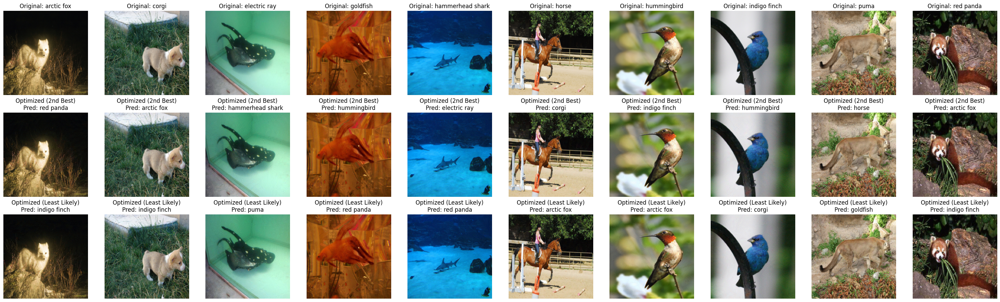

In [52]:
fig, axes = plt.subplots(3, len(adversarial_images), figsize=(30, 9))

for i, (class_name, img_path) in enumerate(adversarial_images.items()):
    original_img_np = tensor_to_image(load_image(img_path))  # Convert original image
    optimized_next_np = tensor_to_image(optimized_images_next[class_name])  # Second best class
    optimized_lowest_np = tensor_to_image(optimized_images_lowest[class_name])  # Least likely class

    # Get predicted class names for adversarial images
    pred_next = torch.argmax(model(optimized_images_next[class_name])).item()
    pred_lowest = torch.argmax(model(optimized_images_lowest[class_name])).item()

    axes[0, i].imshow(original_img_np)
    axes[0, i].set_title(f"Original: {class_name}")
    axes[0, i].axis("off")

    axes[1, i].imshow(optimized_next_np)
    axes[1, i].set_title(f"Optimized (2nd Best)\nPred: {class_names[pred_next]}")
    axes[1, i].axis("off")

    axes[2, i].imshow(optimized_lowest_np)
    axes[2, i].set_title(f"Optimized (Least Likely)\nPred: {class_names[pred_lowest]}")
    axes[2, i].axis("off")

plt.tight_layout()
plt.show()

In [65]:
# Function to Plot Noise
def plot_noise(noise, ax, title):
    noise_np = noise.permute(1, 2, 0).numpy()
    max_abs = max(np.abs(noise_np).max(), 1e-8)  # Avoid division by zero
    im = ax.imshow(noise_np, cmap='seismic', vmin=-max_abs, vmax=max_abs)
    ax.set_title(title)
    ax.axis('off')
    return im

def plot_difference(original, optimized, ax, title, magnify=False):
    difference = torch.abs(original - optimized).mean(dim=0).detach().cpu()

    if magnify:
        difference *= 10  # Magnification factor

    min_val, max_val = difference.min(), difference.max()
    stretched_difference = (difference - min_val) / (max_val - min_val + 1e-8)

    ax.imshow(stretched_difference.numpy().transpose(1, 2, 0), cmap="inferno")  # Fix shape
    ax.set_title(title)
    ax.axis("off")

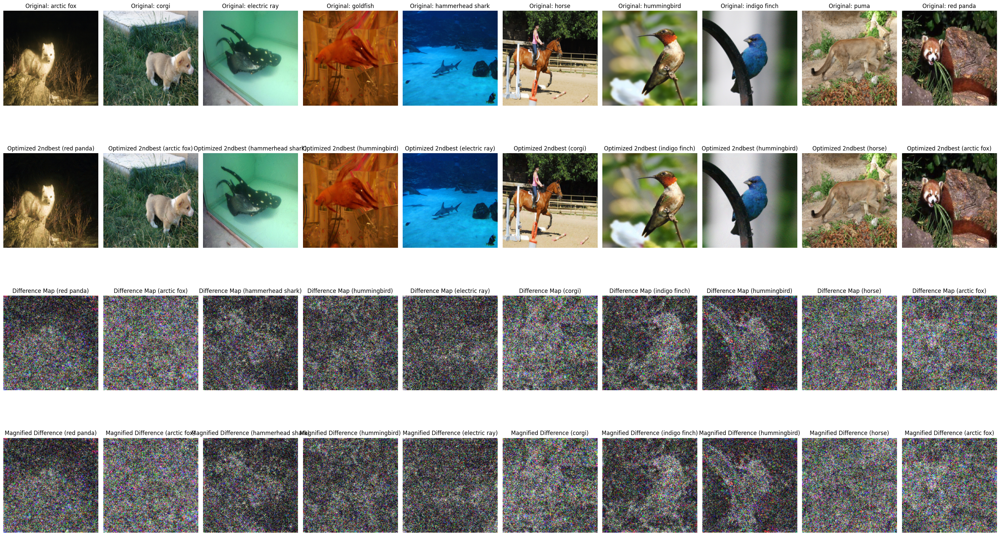

In [67]:
fig, axes = plt.subplots(4, len(adversarial_images), figsize=(30, 18))

for i, (class_name, img_path) in enumerate(adversarial_images.items()):
    img = load_image(img_path)
    optimized_next = optimized_images_next[class_name]
    
    # Get predicted second-best class
    pred_next = torch.argmax(model(optimized_next)).item()
    
    # Convert tensors to images
    original_np = tensor_to_image(img)
    optimized_next_np = tensor_to_image(optimized_next)

    # Compute noise difference
    noise_next = (optimized_next - img).squeeze(0).cpu()
    magnified_noise_next = noise_next * 10  # Magnification factor

    # Row 1: Original image
    axes[0, i].imshow(original_np)
    axes[0, i].set_title(f"Original: {class_name}")
    axes[0, i].axis("off")

    # Row 2: Optimized image (Second Best)
    axes[1, i].imshow(optimized_next_np)
    axes[1, i].set_title(f"Optimized 2ndbest ({class_names[pred_next]})")  # ✅ Shows actual 2nd best class
    axes[1, i].axis("off")

    # Row 3: Difference map
    plot_difference(img, optimized_next, axes[2, i], f"Difference Map ({class_names[pred_next]})")

    # Row 4: Magnified difference map
    plot_difference(img, optimized_next, axes[3, i], f"Magnified Difference ({class_names[pred_next]})", magnify=True)

plt.tight_layout()
plt.show()

This was for Second most probably

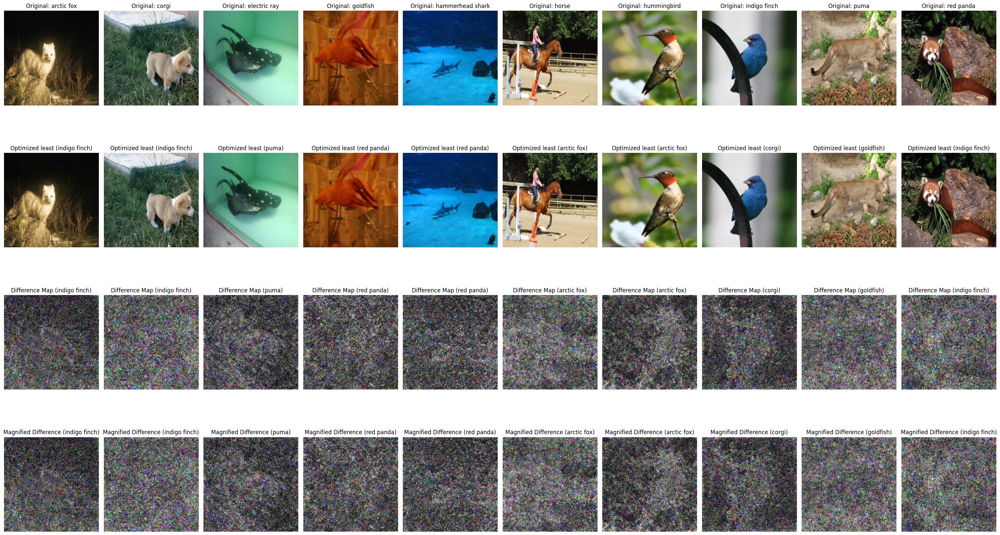

In [68]:
fig, axes = plt.subplots(4, len(adversarial_images), figsize=(30, 18))

for i, (class_name, img_path) in enumerate(adversarial_images.items()):
    img = load_image(img_path)
    optimized_lowest = optimized_images_lowest[class_name]
    
    # Get predicted least likely class
    pred_lowest = torch.argmax(model(optimized_lowest)).item()
    
    # Convert tensors to images
    original_np = tensor_to_image(img)
    optimized_lowest_np = tensor_to_image(optimized_lowest)

    # Compute noise difference
    noise_lowest = (optimized_lowest - img).squeeze(0).cpu()
    magnified_noise_lowest = noise_lowest * 10  # Magnification factor

    # Row 1: Original image
    axes[0, i].imshow(original_np)
    axes[0, i].set_title(f"Original: {class_name}")
    axes[0, i].axis("off")

    # Row 2: Optimized image (Least Likely)
    axes[1, i].imshow(optimized_lowest_np)
    axes[1, i].set_title(f"Optimized least ({class_names[pred_lowest]})")  # ✅ Shows actual least likely class
    axes[1, i].axis("off")

    # Row 3: Difference map
    plot_difference(img, optimized_lowest, axes[2, i], f"Difference Map ({class_names[pred_lowest]})")

    # Row 4: Magnified difference map
    plot_difference(img, optimized_lowest, axes[3, i], f"Magnified Difference ({class_names[pred_lowest]})", magnify=True)

plt.tight_layout()
plt.show()

This is for least probable

In [70]:
for class_name, img_path in adversarial_images.items():
    pred_original = torch.argmax(model(load_image(img_path))).item()
    pred_next = torch.argmax(model(optimized_images_next[class_name])).item()
    pred_lowest = torch.argmax(model(optimized_images_lowest[class_name])).item()

    print(f"{class_name} → Original: {class_names[pred_original]}, "
          f"2nd Best: {class_names[pred_next]}, "
          f"Least Likely: {class_names[pred_lowest]}")

arctic fox → Original: arctic fox, 2nd Best: red panda, Least Likely: indigo finch
corgi → Original: corgi, 2nd Best: arctic fox, Least Likely: indigo finch
electric ray → Original: electric ray, 2nd Best: hammerhead shark, Least Likely: puma
goldfish → Original: goldfish, 2nd Best: hummingbird, Least Likely: red panda
hammerhead shark → Original: hammerhead shark, 2nd Best: electric ray, Least Likely: red panda
horse → Original: horse, 2nd Best: corgi, Least Likely: arctic fox
hummingbird → Original: hummingbird, 2nd Best: indigo finch, Least Likely: arctic fox
indigo finch → Original: indigo finch, 2nd Best: hummingbird, Least Likely: corgi
puma → Original: puma, 2nd Best: horse, Least Likely: goldfish
red panda → Original: red panda, 2nd Best: arctic fox, Least Likely: indigo finch


it is classifying it wrongly as expected